# Visium Object Loading

Download the [data here](https://s3.embl.de/spatialdata/spatialdata-sandbox/visium_associated_xenium_io.zip). Change the path (variable `ddd`) below as needed.

In [1]:
%load_ext autoreload
%autoreload 2

from corescpy import Spatial
import scanpy as sc
import squidpy as sq
import functools
import os
from os import system
import pandas as pd

ddd = os.path.join(os.path.expanduser("~"), "projects/data/public/visium")

pd.options.display.max_columns = 100

# genes = ["CDKN1A", "CDKN2A", "TP53", "PLAUR",
#          "PTGER4", "ATG16L1", "NOD2", "LACC1"]
# cell_types = None
# palette = "tab20"

genes = dict(CSF=["CSF2", "CSF2RB", "CSF2RA"],
             All_ILCs=["IL7R"],
             ILC1=["TBX21", "KLRB1", "CCL5", "HSP90AA1", "IFNG"],
             ILC3=["RORC", "IL23R", "KIT", "CCL20", "TCF7", "IL22"],
             Cytokines=["IFNG", "IL22"])  # ILC1 & ILC3, respectively
cell_types = ["ILC3", "LTi-like NCR+ ILC3", "LTi-like NCR- ILC3",
              "ILCP", "Macrophages", "Stem cells"]
# palette = ["r", "tab:pink", "m", "b", "tab:brown", "cyan"]
palette = "tab10"

kws_pp = dict(cell_filter_pmt=[0, 100], cell_filter_ncounts=None,
              cell_filter_ngene=[0, None], gene_filter_ncell=[3, None],
              gene_filter_ncounts=None)  # can call using 1 arguments

ryp2 is not installed. Install with pip install rpy2 to run tools with R support.

# Data

In [2]:
selves = []
for s in zip(["Post-Xenium"], ["_Post_Xenium"]):
    for i, n in enumerate(["Rep1", "Rep2"]):
        d_p = os.path.join(ddd, f"CytAssist_FFPE_Human_Colon/{s[0]}/{n}")
        self = Spatial(d_p, visium=True, col_cell_type="leiden")
        self.adata.obs = self.adata.obs.assign(Condition=s[0])
        self.adata.obs = self.adata.obs.assign(Replicate=i)
        self.adata.obs = self.adata.obs.assign(Sample=f"{s[0]}_{n}")
        # self._columns["col_sample_id"] = "Sample"
        # self._columns["col_condition"] = "Condition"
        selves += [self]



<<< INITIALIZING SPATIAL CLASS OBJECT >>>



<<< INITIALIZING OMICS CLASS OBJECT >>>

Unused keyword arguments: {'library_id': None, 'visium': True}.




col_gene_symbols="gene_symbols"
col_cell_type="leiden"
col_sample_id="Sample"
col_batch="Sample"
col_subject=None
col_condition=None
col_num_umis=None



key_control=None
key_treatment=None
dsfasfda AnnData object with n_obs × n_vars = 6518 × 18085
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'


Cell Counts: Initial


Observations: 6518



Gene Counts: Initial

Empty DataFrame
Columns: [index, gene_ids, feature_types, genome]
Index: []





 AnnData object with n_obs × n_vars = 6518 × 18085
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'
    layers: 'counts'


 AnnData object with n_obs × n_vars = 6518 × 18085
    obs: 'in_tissue', 'array_row', 'array_col'
    var

## Preprocessing


Un-Used Keyword Arguments: {'assay_protein': None, 'col_subject': None, 'col_condition': None, 'col_num_umis': None}




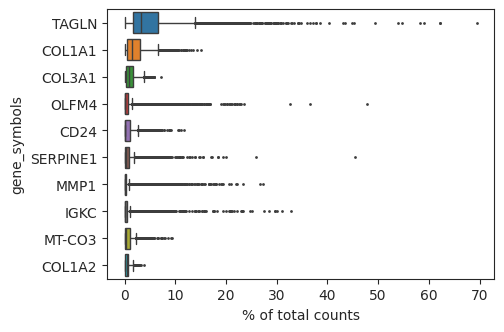

dsfasfda AnnData object with n_obs × n_vars = 6352 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'Sample', 'Condition', 'Replicate', 'n_counts', 'log_counts', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'
    layers: 'counts'


Cell Counts: Initial


Observations: 6352



Gene Counts: Initial

Empty DataFrame
Columns: [gene_symbols, gene_ids, feature_types, genome]
Index: []




<<< PERFORMING QUALITY CONTROL ANALYSIS>>>

	*** Detecting Mitochondrial, Ribosomal, Hemoglobin genes...

	*** Calculating & plotting QC metrics...




... storing 'Sample' as categorical
... storing 'Condition' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


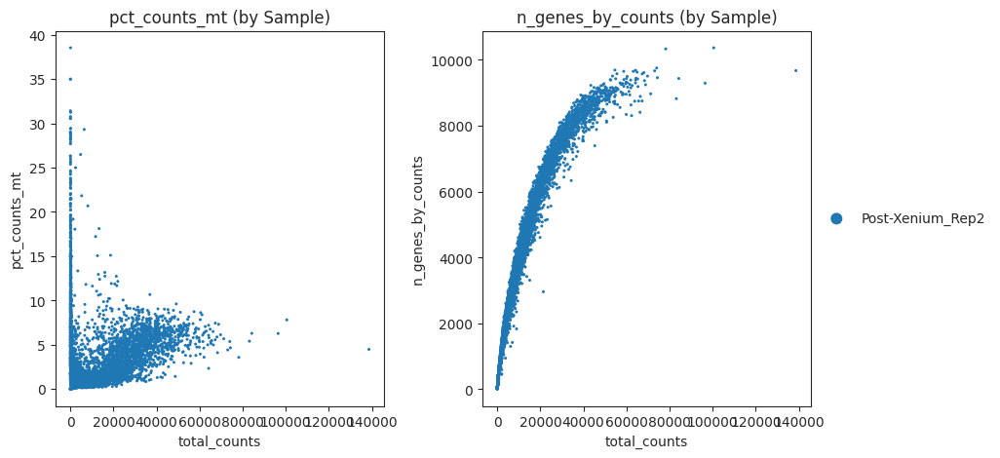


<<< FILTERING CELLS (TOO FEW GENES) & GENES (TOO FEW CELLS) >>>
dsfasfda AnnData object with n_obs × n_vars = 6352 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'Sample', 'Condition', 'Replicate', 'n_counts', 'log_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial', 'Sample_colors'
    obsm: 'spatial'
    layers: 'counts'


Cell Counts: Post-Basic Filter


Observations: 6352



Gene Counts: Post-Basic Filter

     n_cells_by_counts  mean_counts  log1p_mean_counts  pct_dropout_by_counts  \
25%              105.0     0.017475           0

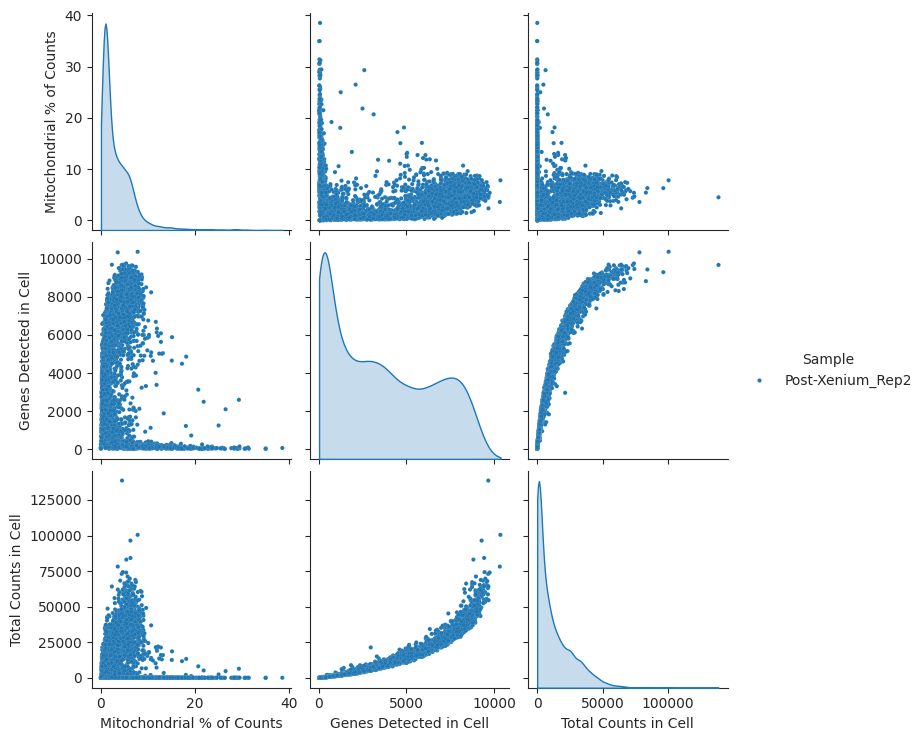

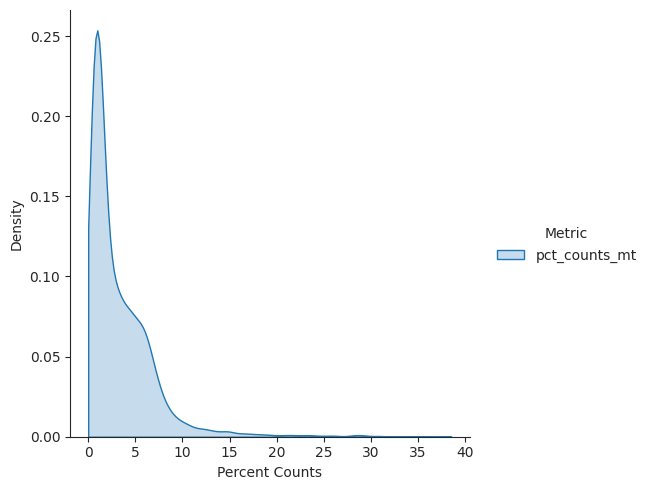

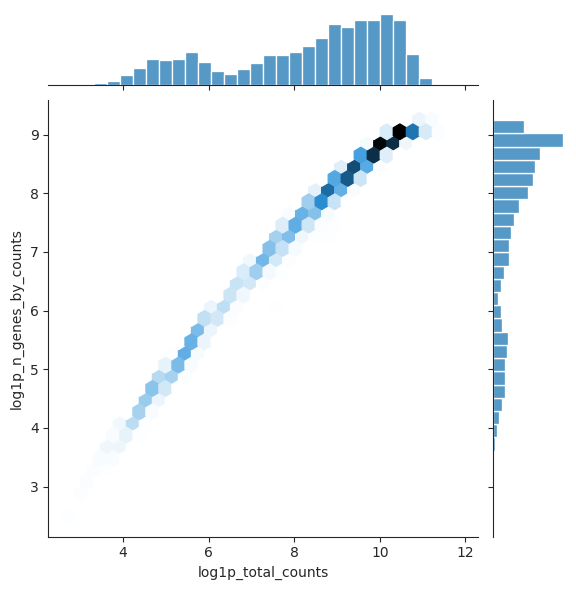

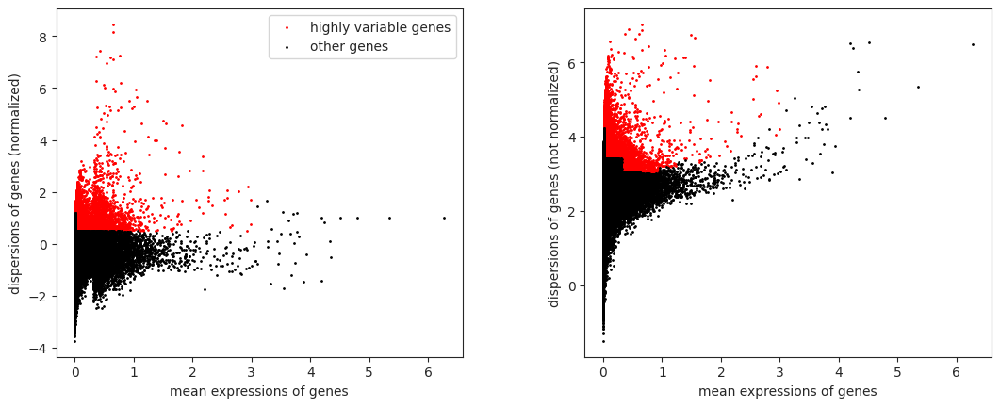


<<< NORMALIZING RAW GENE EXPRESSION >>>

	*** Scaling gene expression...

	*** Scaling => `.X` & scaled layer...
dsfasfda AnnData object with n_obs × n_vars = 6352 × 18015
    obs: 'in_tissue', 'array_row', 'array_col', 'Sample', 'Condition', 'Replicate', 'n_counts', 'log_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'spatial', 'Sample_colors', 'log1p', 'hvg'
    obsm: 'spatial'
    layers: 'counts', 'log1p', 'scaled'


Cell Counts: Post-Processing


Observation

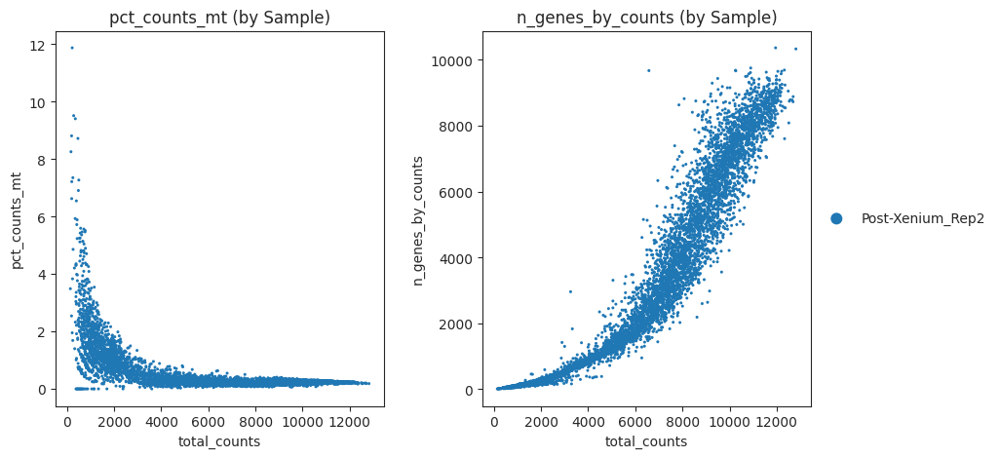

CPU times: user 46.3 s, sys: 37.5 s, total: 1min 23s
Wall time: 23.7 s


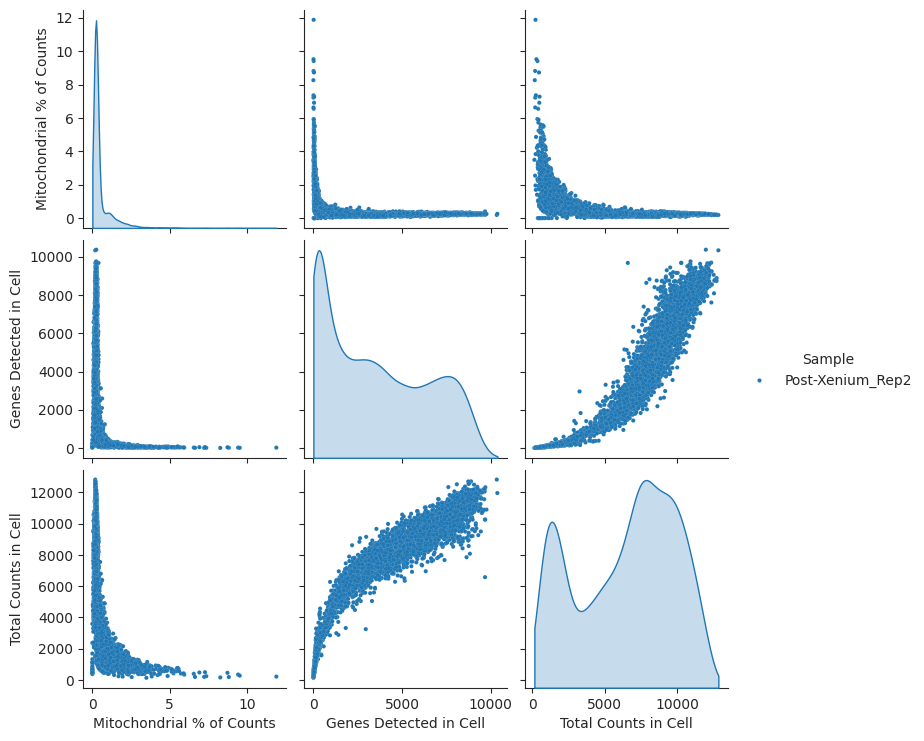

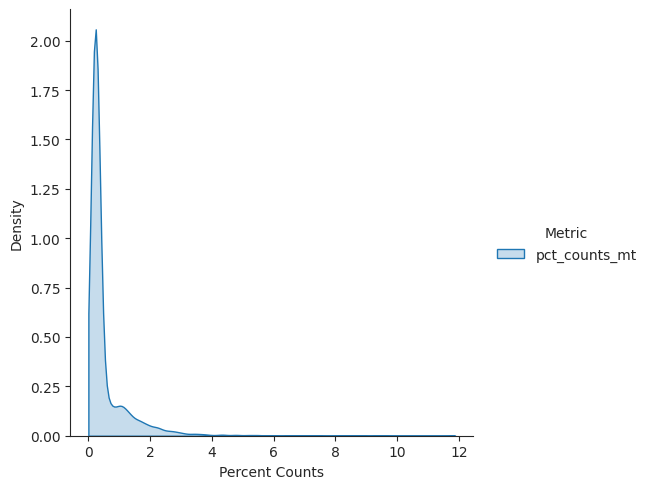

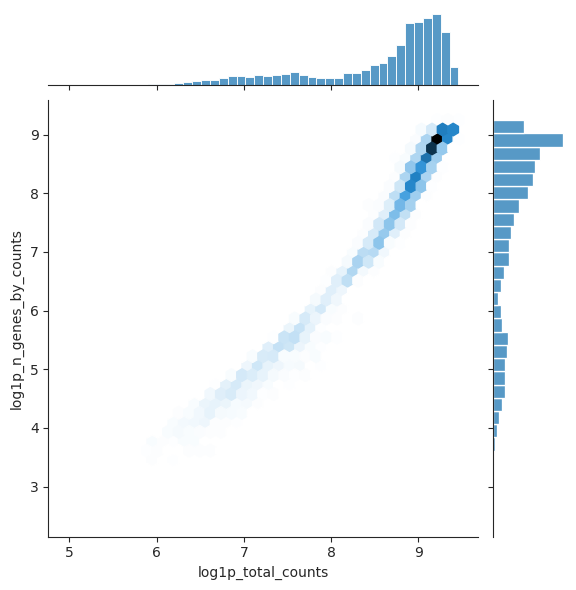

In [3]:
%%time

_ = self.preprocess(**kws_pp)

## Clustering



Un-used Keyword Arguments: {'assay': None, 'col_gene_symbols': 'gene_symbols', 'col_cell_type': 'leiden', 'col_sample_id': 'Sample', 'col_batch': 'Sample', 'col_subject': None, 'col_condition': None, 'col_num_umis': None, 'key_control': None, 'key_treatment': None}


<<< PERFORMING PCA >>>

 {'use_highly_variable': True}


<<< COMPUTING NEIGHBORHOOD GRAPH >>>


<<< EMBEDDING: UMAP >>>


<<< CLUSTERING WITH LEIDEN METHOD >>>


<<< CREATING UMAP PLOTS >>>


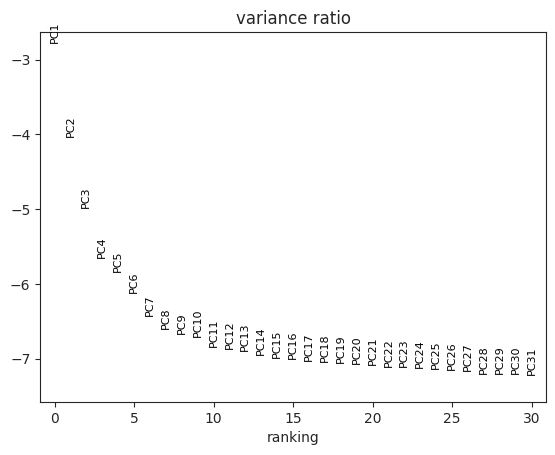

... storing 'assay_protein' as categorical
... storing 'col_gene_symbols' as categorical
... storing 'col_cell_type' as categorical
... storing 'col_sample_id' as categorical
... storing 'col_batch' as categorical
... storing 'col_subject' as categorical
... storing 'col_condition' as categorical
... storing 'col_num_umis' as categorical
... storing 'cell_filter_pmt' as categorical
... storing 'cell_filter_ncounts' as categorical
... storing 'cell_filter_ngene' as categorical
... storing 'gene_filter_ncell' as categorical
... storing 'gene_filter_ncounts' as categorical
... storing 'kws_scale' as categorical
... storing 'method_cluster' as categorical


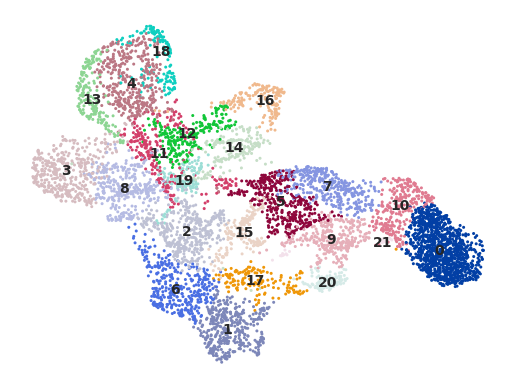

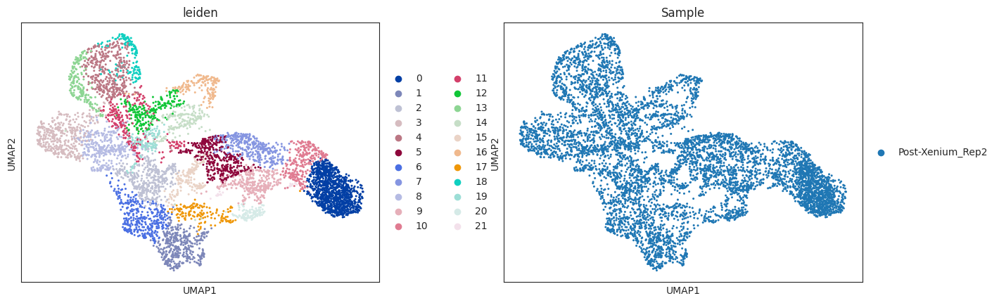

CPU times: user 20min 58s, sys: 30min 16s, total: 51min 14s
Wall time: 1min 33s


In [4]:
%%time

_ = self.cluster()

# Variables

In [5]:
cell_types = list(self.rna.obs[self._columns["col_cell_type"]].sample(3))

# Centrality Scores

	*** Building connectivity matrix...
	*** Computing & plotting centrality scores...


Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

	*** Computing interaction matrix...
CPU times: user 9.04 s, sys: 4.12 s, total: 13.2 s
Wall time: 18.8 s


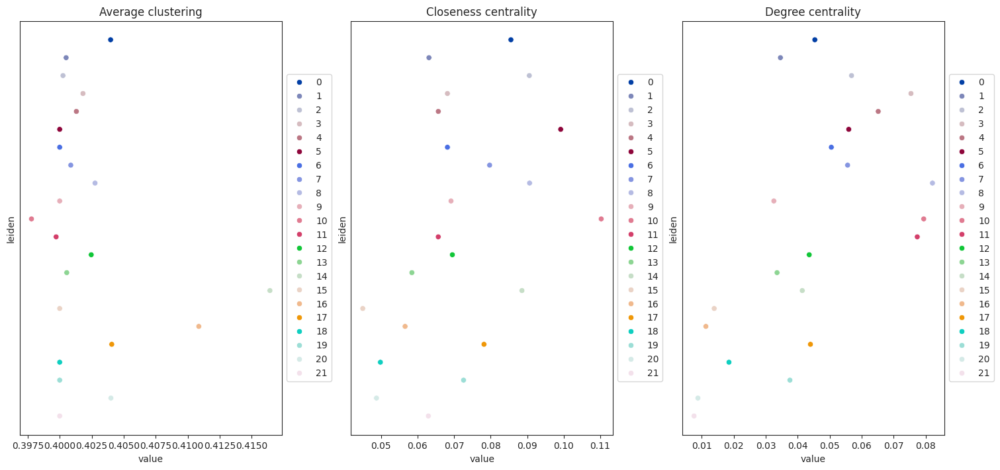

In [6]:
%%time

_ = self.calculate_centrality(n_jobs=4)

# Cell Type Co-Occurrence

  0%|          | 0/1 [00:00<?, ?/s]

... storing 'kws_pca' as categorical
... storing 'kws_neighbors' as categorical
... storing 'kws_umap' as categorical
... storing 'kws_cluster' as categorical
... storing 'resolution' as categorical


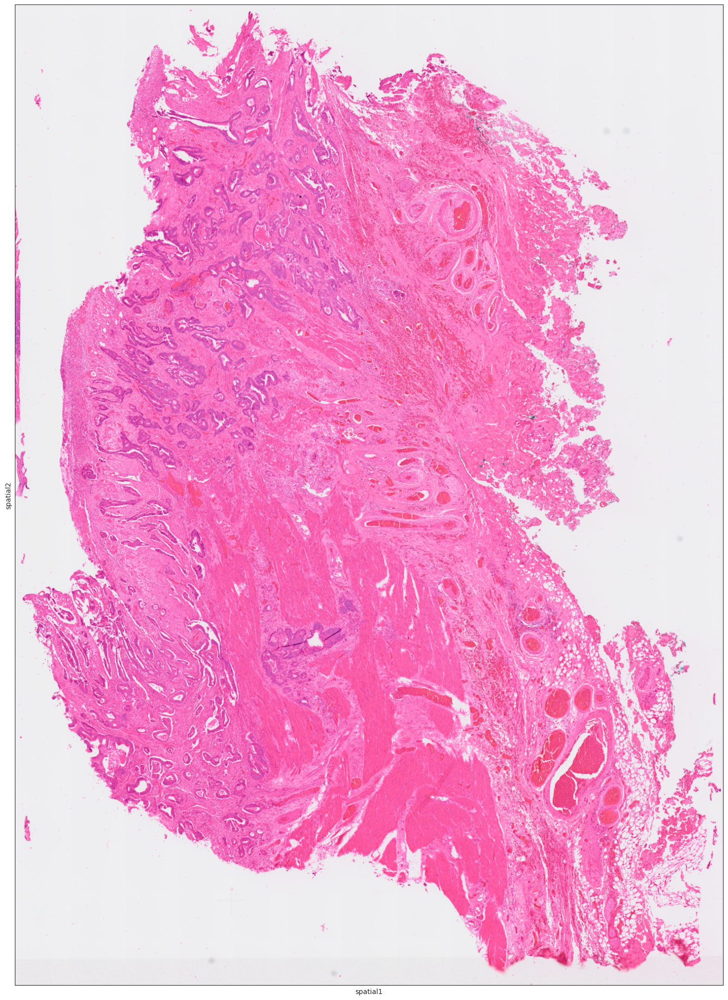

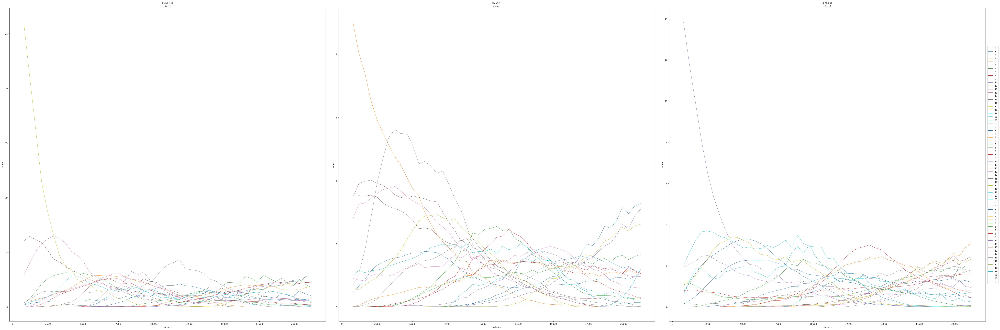

CPU times: user 10 s, sys: 14.4 s, total: 24.5 s
Wall time: 33 s


In [7]:
%%time

_ = self.find_cooccurrence(key_cell_type=cell_types, figsize=(60, 20),
                           palette=palette, kws_plot=dict(wspace=3))

# Neighbors Enrichment Analysis

  0%|          | 0/1000 [00:00<?, ?/s]

... storing 'kws_pca' as categorical
... storing 'kws_neighbors' as categorical
... storing 'kws_umap' as categorical
... storing 'kws_cluster' as categorical
... storing 'resolution' as categorical


CPU times: user 7.66 s, sys: 1.09 s, total: 8.75 s
Wall time: 9.22 s


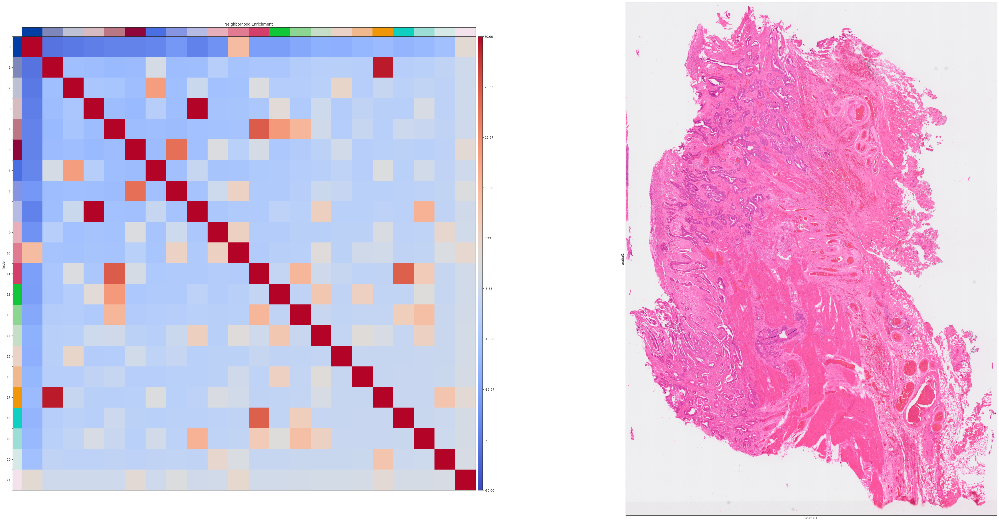

In [8]:
%%time

_ = self.calculate_neighborhood(figsize=(60, 30), cmap="coolwarm",
                                cbar_range=[-30, 30])

# Spatially-Variable Genes


<<< QUANTIFYING AUTO-CORRELATION (method = moran) >>>


  0%|          | 0/10 [00:00<?, ?/s]

... storing 'kws_pca' as categorical
... storing 'kws_neighbors' as categorical
... storing 'kws_umap' as categorical
... storing 'kws_cluster' as categorical
... storing 'resolution' as categorical


CPU times: user 22.8 s, sys: 4.41 s, total: 27.2 s
Wall time: 34.6 s


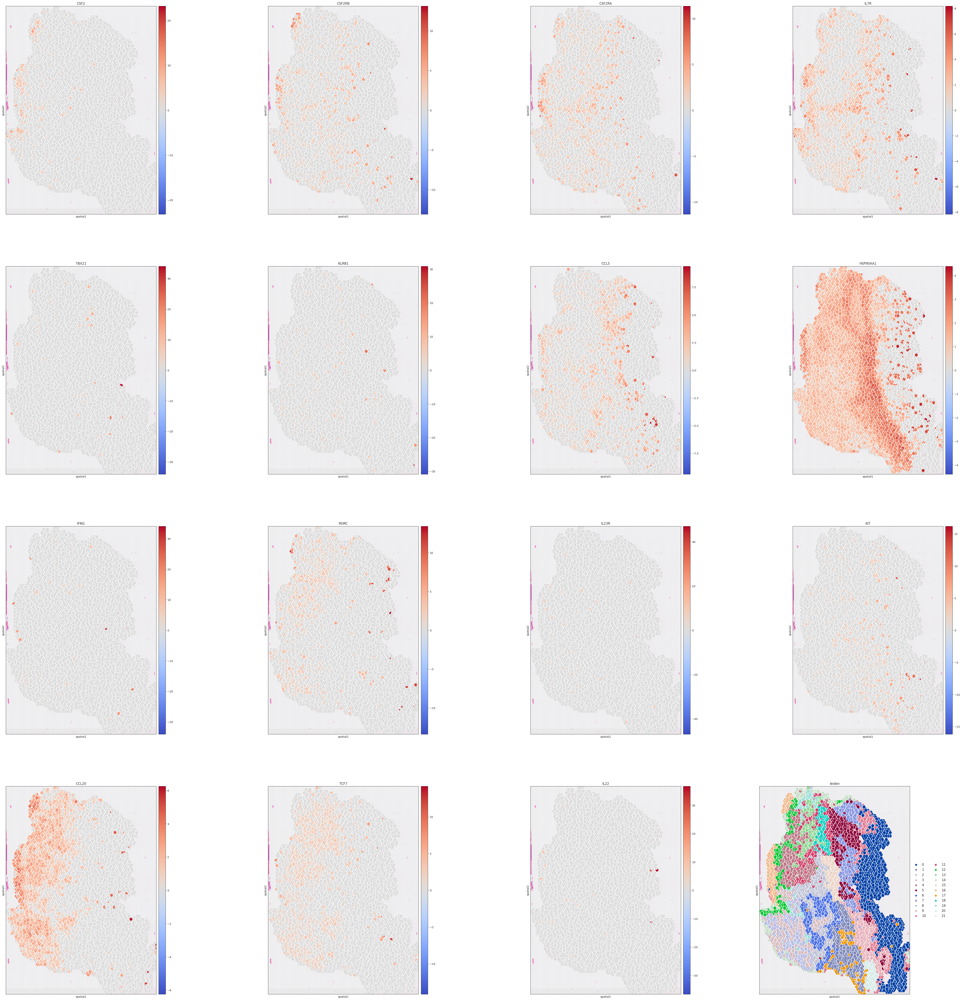

In [9]:
%%time

ggg = genes if genes and isinstance(genes, dict) else {"Genes": genes}
genes_all = functools.reduce(lambda i, j: i + j, [ggg[g] for g in ggg])
# for g in ggg:
#   self.find_svgs(genes=ggg[g])
fig = self.find_svgs(
    genes=genes_all, method="moran", n_perms=10, kws_plot=dict(
        wspace=0.1, cmap="coolwarm", vcenter=0, size=3,
        legend_fontsize="large"), figsize=(15, 15))

# Receptor-Ligand Interactions

Using `.X`!
Using resource `cellphonedb`.
0.05 of entities in the resource are missing from the data.


Generating ligand-receptor stats for 6352 samples and 18015 features


100%|██████████| 1000/1000 [00:16<00:00, 62.30it/s]
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


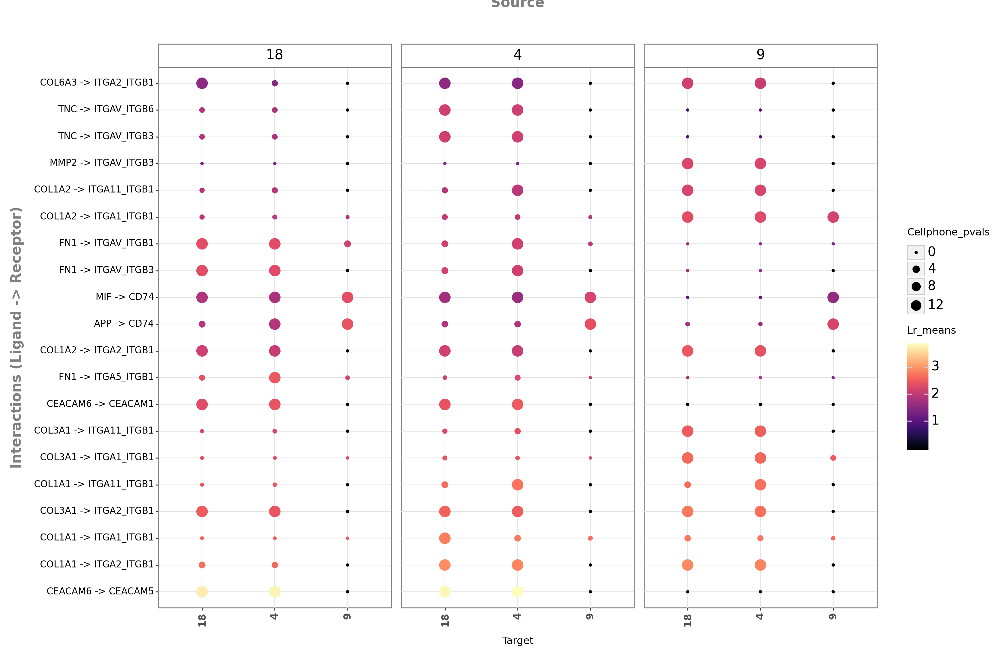


CPU times: user 1min 6s, sys: 1min 7s, total: 2min 13s
Wall time: 2min 13s


In [10]:
%%time

out = self.calculate_receptor_ligand(
    key_sources=cell_types, key_targets=cell_types, col_condition=False,
    p_threshold=0.001, remove_ns=True, figsize=(15, 10))